In [1]:

print("welcome to the project")

welcome to the project


In [ ]:
import os
import json
from collections import Counter

metadata_folder = r"C:\Users\kanam\OneDrive\Desktop\ms thesis\256x256\2d_resized_256\metadata"

labels = []

if not os.path.exists(metadata_folder):
    print(f"Error: The folder '{metadata_folder}' does not exist.")
    exit()

for filename in os.listdir(metadata_folder):
    if filename.endswith('.json'):
        file_path = os.path.join(metadata_folder, filename)
        try:
            with open(file_path, 'r') as f:
                metadata = json.load(f)
                label = metadata.get("label", "Unknown")
                labels.append(label)
        except Exception as e:
            print(f"Error reading file {filename}: {e}")

label_counts = Counter(labels)

if label_counts:
    print("Image Counts by Type:")
    for label, count in label_counts.items():
        print(f"{label}: {count}")
else:
    print("No labels found in the metadata.")


Image Counts by Type:
NonCancer: 154238
Unknown: 1979
IndexCancer: 5803
PreIndexCancer: 1548


In [1]:
import os
import json
from collections import defaultdict

# Update the path to your metadata folder
metadata_folder = r"C:\Users\kanam\OneDrive\Desktop\ms thesis\256x256\2d_resized_256\metadata"

# Dictionary to store PatientID and their corresponding views
patient_views = defaultdict(set)

# Check if the folder exists
if not os.path.exists(metadata_folder):
    print(f"Error: The folder '{metadata_folder}' does not exist.")
    exit()

# Process each metadata file
for filename in os.listdir(metadata_folder):
    if filename.endswith('.json'):
        file_path = os.path.join(metadata_folder, filename)
        try:
            with open(file_path, 'r') as f:
                metadata = json.load(f)
                patient_id = metadata.get("PatientID", "Unknown")
                view = metadata.get("View", "Unknown")
                patient_views[patient_id].add(view)
        except Exception as e:
            print(f"Error reading file {filename}: {e}")

# Define the set of all possible views
all_views = {"cranio-caudal", "medio-lateral", "lateral", "other-view"}  # Update "other-view" as needed

# Count patients with all 4 views
patients_with_all_views = sum(1 for views in patient_views.values() if all_views.issubset(views))

# Output the result
print(f"Number of patients with all 4 views: {patients_with_all_views}")


Number of patients with all 4 views: 0


In [2]:
import os
import json

# Path to your metadata folder
metadata_folder = r"C:\Users\kanam\OneDrive\Desktop\ms thesis\256x256\2d_resized_256\metadata"

# Set to store unique views
unique_views = set()

if not os.path.exists(metadata_folder):
    print(f"Error: The folder '{metadata_folder}' does not exist.")
    exit()

for filename in os.listdir(metadata_folder):
    if filename.endswith('.json'):
        file_path = os.path.join(metadata_folder, filename)
        try:
            with open(file_path, 'r') as f:
                metadata = json.load(f)
                view = metadata.get("View", "Unknown")
                unique_views.add(view)
        except Exception as e:
            print(f"Error reading file {filename}: {e}")

# Output unique views
print(f"Unique Views in Dataset: {unique_views}")


Unique Views in Dataset: {'medio-lateral', 'medio-lateral oblique', 'cranio-caudal', 'mediolateral oblique', 'craniocaudal'}


In [3]:
import os
import json
from collections import defaultdict

# Path to your metadata folder
metadata_folder = r"C:\Users\kanam\OneDrive\Desktop\ms thesis\256x256\2d_resized_256\metadata"

# Normalize view names
def normalize_view(view):
    view_mapping = {
        'cranio-caudal': 'craniocaudal',
        'craniocaudal': 'craniocaudal',
        'medio-lateral oblique': 'mediolateral oblique',
        'mediolateral oblique': 'mediolateral oblique',
        'medio-lateral': 'medio-lateral'
    }
    return view_mapping.get(view, view)

# Initialize patient data
patient_views = defaultdict(set)

if not os.path.exists(metadata_folder):
    print(f"Error: The folder '{metadata_folder}' does not exist.")
    exit()

# Read metadata and collect views for each patient
for filename in os.listdir(metadata_folder):
    if filename.endswith('.json'):
        file_path = os.path.join(metadata_folder, filename)
        try:
            with open(file_path, 'r') as f:
                metadata = json.load(f)
                patient_id = metadata.get("PatientID", "Unknown")
                view = normalize_view(metadata.get("View", "Unknown"))
                patient_views[patient_id].add(view)
        except Exception as e:
            print(f"Error reading file {filename}: {e}")

# Define the required views
all_views = {'craniocaudal', 'mediolateral oblique', 'medio-lateral'}

# Count patients with all required views
patients_with_all_views = [
    patient_id for patient_id, views in patient_views.items() if all_views.issubset(views)
]

print(f"Number of patients with all 4 views: {len(patients_with_all_views)}")


Number of patients with all 4 views: 0


In [4]:
import os
import json
from collections import defaultdict

# Path to your metadata folder
metadata_folder = r"C:\Users\kanam\OneDrive\Desktop\ms thesis\256x256\2d_resized_256\metadata"

# Normalize view names
def normalize_view(view):
    view_mapping = {
        'cranio-caudal': 'craniocaudal',
        'craniocaudal': 'craniocaudal',
        'medio-lateral oblique': 'mediolateral oblique',
        'mediolateral oblique': 'mediolateral oblique',
        'medio-lateral': 'medio-lateral'
    }
    return view_mapping.get(view, view)

# Initialize patient data
patient_views = defaultdict(set)

if not os.path.exists(metadata_folder):
    print(f"Error: The folder '{metadata_folder}' does not exist.")
    exit()

# Read metadata and collect views for each patient
for filename in os.listdir(metadata_folder):
    if filename.endswith('.json'):
        file_path = os.path.join(metadata_folder, filename)
        try:
            with open(file_path, 'r') as f:
                metadata = json.load(f)
                patient_id = metadata.get("PatientID", "Unknown")
                view = normalize_view(metadata.get("View", "Unknown"))
                patient_views[patient_id].add(view)
        except Exception as e:
            print(f"Error reading file {filename}: {e}")

# Define the required views
all_views = {'craniocaudal', 'mediolateral oblique', 'medio-lateral'}

# Debugging: Log unique views per patient
for patient_id, views in patient_views.items():
    print(f"Patient {patient_id}: {views}")

# Count patients with each required view
for view in all_views:
    count = sum(1 for views in patient_views.values() if view in views)
    print(f"Number of patients with the view '{view}': {count}")

# Count patients with all required views
patients_with_all_views = [
    patient_id for patient_id, views in patient_views.items() if all_views.issubset(views)
]

print(f"Number of patients with all 4 views: {len(patients_with_all_views)}")


Patient DHARD4DRTHSZ: {'craniocaudal'}
Patient DH1AJLIW8A7B: {'craniocaudal'}
Patient DHPF2ISK7NE9: {'craniocaudal'}
Patient DHAIPIQX5VVP: {'mediolateral oblique'}
Patient DHTWWMNB4VSN: {'craniocaudal'}
Patient DH2J8GG1RENS: {'craniocaudal'}
Patient DHFBAXHT2UFT: {'mediolateral oblique'}
Patient DHIGDCIB5GCQ: {'mediolateral oblique'}
Patient DHS3VZPRLUT6: {'mediolateral oblique'}
Patient DHQ4CPXKRZK0: {'mediolateral oblique'}
Patient DHLBF96EP0Y1: {'mediolateral oblique'}
Patient DHIAC5FR55YZ: {'craniocaudal'}
Patient DH8AGTH95F73: {'craniocaudal'}
Patient DHT6STX9AHIZ: {'mediolateral oblique'}
Patient DHJU3RRNKARA: {'mediolateral oblique'}
Patient DH6RN7K6DT3D: {'mediolateral oblique'}
Patient DHQ4DXH7VH9Q: {'craniocaudal'}
Patient DHERT5U7PBEY: {'craniocaudal'}
Patient DHR4CE2BQW4X: {'craniocaudal'}
Patient DH4EQCA86ENE: {'mediolateral oblique'}
Patient DHYSDUIJANWF: {'craniocaudal'}
Patient DHVW2Q1NTRAI: {'craniocaudal'}
Patient DHVK0IAAXN6B: {'mediolateral oblique'}
Patient DHM7GW8

In [2]:

import os
import json
from collections import defaultdict

metadata_folder = r"C:\Users\kanam\OneDrive\Desktop\ms thesis\256x256\2d_resized_256\metadata"

# Dictionary to store patients and their views
patients_views = defaultdict(set)

# Check if the folder exists
if not os.path.exists(metadata_folder):
    print(f"Error: The folder '{metadata_folder}' does not exist.")
    exit()

# Process each metadata file
for filename in os.listdir(metadata_folder):
    if filename.endswith('.json'):
        file_path = os.path.join(metadata_folder, filename)
        try:
            with open(file_path, 'r') as f:
                metadata = json.load(f)
                patient_id = metadata.get("PatientID")
                view = metadata.get("View")
                laterality = metadata.get("ImageLaterality")

                # Categorize views into the 4 categories
                if 'oblique' in view.lower():
                    categorized_view = 'Mediolateral Oblique'
                elif 'craniocaudal' in view.lower():
                    categorized_view = 'Craniocaudal'
                else:
                    categorized_view = 'Mediolateral'
                
                # Add the laterality information (Left or Right) 
                if laterality and 'L' in laterality.upper():
                    laterality = 'Left'
                elif laterality and 'R' in laterality.upper():
                    laterality = 'Right'
                else:
                    laterality = 'Unknown'

                # Store the categorized view and laterality for the patient
                patients_views[patient_id].add(f"{categorized_view} - {laterality}")

        except Exception as e:
            print(f"Error reading file {filename}: {e}")

# Counting the patients with each combination of views
views_count = defaultdict(int)
for patient_id, views in patients_views.items():
    for view in views:
        views_count[view] += 1

# Print the results
print("Number of patients with each view category:")
for view, count in views_count.items():
    print(f"{view}: {count}")


Number of patients with each view category:
Mediolateral - Right: 41528
Mediolateral - Left: 41366
Mediolateral Oblique - Left: 39795
Mediolateral Oblique - Right: 40225
Craniocaudal - Left: 1


In [1]:
import os#try1
import json
from collections import defaultdict, Counter

# Path to your metadata folder
metadata_folder = r"C:\Users\kanam\OneDrive\Desktop\ms thesis\256x256\2d_resized_256\metadata"

# Ensure the metadata folder exists
if not os.path.exists(metadata_folder):
    print(f"Error: The folder '{metadata_folder}' does not exist.")
    exit()

# Initialize data structures
labels = []
unique_views = set()
patient_views = defaultdict(set)

# Define the set of all possible views
all_views = {"cranio-caudal", "medio-lateral", "lateral", "other-view"}  # Update as needed

# Process each metadata file
for filename in os.listdir(metadata_folder):
    if filename.endswith('.json'):
        file_path = os.path.join(metadata_folder, filename)
        try:
            with open(file_path, 'r') as f:
                metadata = json.load(f)
                
                # Extract labels
                label = metadata.get("label", "Unknown")
                labels.append(label)
                
                # Extract unique views
                view = metadata.get("View", "Unknown")
                unique_views.add(view)
                
                # Map patient IDs to views
                patient_id = metadata.get("PatientID", "Unknown")
                patient_views[patient_id].add(view)
        except Exception as e:
            print(f"Error reading file {filename}: {e}")

# Analyze labels
label_counts = Counter(labels)
print("Image Counts by Type:")
for label, count in label_counts.items():
    print(f"{label}: {count}")

# Output unique views
print(f"\nUnique Views in Dataset: {unique_views}")

# Count patients with all 4 views
patients_with_all_views = sum(1 for views in patient_views.values() if all_views.issubset(views))
print(f"\nNumber of patients with all 4 views: {patients_with_all_views}")

# Output views per patient
print("\nPatient Views:")
for patient_id, views in patient_views.items():
    print(f"Patient {patient_id}: {views}")


Image Counts by Type:
NonCancer: 154238
Unknown: 1979
IndexCancer: 5803
PreIndexCancer: 1548

Unique Views in Dataset: {'craniocaudal', 'mediolateral oblique', 'cranio-caudal', 'medio-lateral', 'medio-lateral oblique'}

Number of patients with all 4 views: 0

Patient Views:
Patient DHARD4DRTHSZ: {'cranio-caudal'}
Patient DH1AJLIW8A7B: {'cranio-caudal'}
Patient DHPF2ISK7NE9: {'cranio-caudal'}
Patient DHAIPIQX5VVP: {'medio-lateral oblique'}
Patient DHTWWMNB4VSN: {'cranio-caudal'}
Patient DH2J8GG1RENS: {'cranio-caudal'}
Patient DHFBAXHT2UFT: {'medio-lateral oblique'}
Patient DHIGDCIB5GCQ: {'medio-lateral oblique'}
Patient DHS3VZPRLUT6: {'medio-lateral oblique'}
Patient DHQ4CPXKRZK0: {'medio-lateral oblique'}
Patient DHLBF96EP0Y1: {'medio-lateral oblique'}
Patient DHIAC5FR55YZ: {'cranio-caudal'}
Patient DH8AGTH95F73: {'cranio-caudal'}
Patient DHT6STX9AHIZ: {'medio-lateral oblique'}
Patient DHJU3RRNKARA: {'medio-lateral oblique'}
Patient DH6RN7K6DT3D: {'medio-lateral oblique'}
Patient DHQ4D

In [2]:
import os#try2
import json
from collections import defaultdict

metadata_folder = r"C:\Users\kanam\OneDrive\Desktop\ms thesis\256x256\2d_resized_256\metadata"

# Dictionary to store patients and their views
patients_views = defaultdict(set)

# Check if the folder exists
if not os.path.exists(metadata_folder):
    print(f"Error: The folder '{metadata_folder}' does not exist.")
    exit()

# Process each metadata file
for filename in os.listdir(metadata_folder):
    if filename.endswith('.json'):
        file_path = os.path.join(metadata_folder, filename)
        try:
            with open(file_path, 'r') as f:
                metadata = json.load(f)
                
                # Extract data
                patient_id = metadata.get("PatientID")
                view = metadata.get("View", "").lower()
                laterality = metadata.get("ImageLaterality", "").upper()

                # Skip files with missing data
                if not patient_id or not view:
                    print(f"Skipping file {file_path} due to missing data.")
                    continue

                # Categorize views
                if 'oblique' in view:
                    categorized_view = 'Mediolateral Oblique'
                elif 'cranio' in view:
                    categorized_view = 'Craniocaudal'
                else:
                    categorized_view = 'Mediolateral'

                # Determine laterality
                if 'L' in laterality:
                    laterality = 'Left'
                elif 'R' in laterality:
                    laterality = 'Right'
                else:
                    laterality = 'Unknown'

                # Store the categorized view and laterality for the patient
                patients_views[patient_id].add(f"{categorized_view} - {laterality}")

        except Exception as e:
            print(f"Error reading file {filename}: {e}")

# Counting the patients with each combination of views
views_count = defaultdict(int)
for patient_id, views in patients_views.items():
    for view in views:
        views_count[view] += 1

# Print the results
print("Number of patients with each view category:")
for view, count in views_count.items():
    print(f"{view}: {count}")


Number of patients with each view category:
Craniocaudal - Right: 41527
Craniocaudal - Left: 41367
Mediolateral Oblique - Left: 39795
Mediolateral Oblique - Right: 40225
Mediolateral - Right: 1


Image Counts by Type:
NonCancer: 154238
Unknown: 1979
IndexCancer: 5803
PreIndexCancer: 1548

Unique Views in Dataset: {'craniocaudal', 'mediolateral oblique', 'cranio-caudal', 'medio-lateral', 'medio-lateral oblique'}

Number of patients with all 4 views: 0

Patient Views (First Script):
Patient DHARD4DRTHSZ: {'cranio-caudal'}
Patient DH1AJLIW8A7B: {'cranio-caudal'}
Patient DHPF2ISK7NE9: {'cranio-caudal'}
Patient DHAIPIQX5VVP: {'medio-lateral oblique'}
Patient DHTWWMNB4VSN: {'cranio-caudal'}
Patient DH2J8GG1RENS: {'cranio-caudal'}
Patient DHFBAXHT2UFT: {'medio-lateral oblique'}
Patient DHIGDCIB5GCQ: {'medio-lateral oblique'}
Patient DHS3VZPRLUT6: {'medio-lateral oblique'}
Patient DHQ4CPXKRZK0: {'medio-lateral oblique'}
Patient DHLBF96EP0Y1: {'medio-lateral oblique'}
Patient DHIAC5FR55YZ: {'cranio-caudal'}
Patient DH8AGTH95F73: {'cranio-caudal'}
Patient DHT6STX9AHIZ: {'medio-lateral oblique'}
Patient DHJU3RRNKARA: {'medio-lateral oblique'}
Patient DH6RN7K6DT3D: {'medio-lateral oblique'

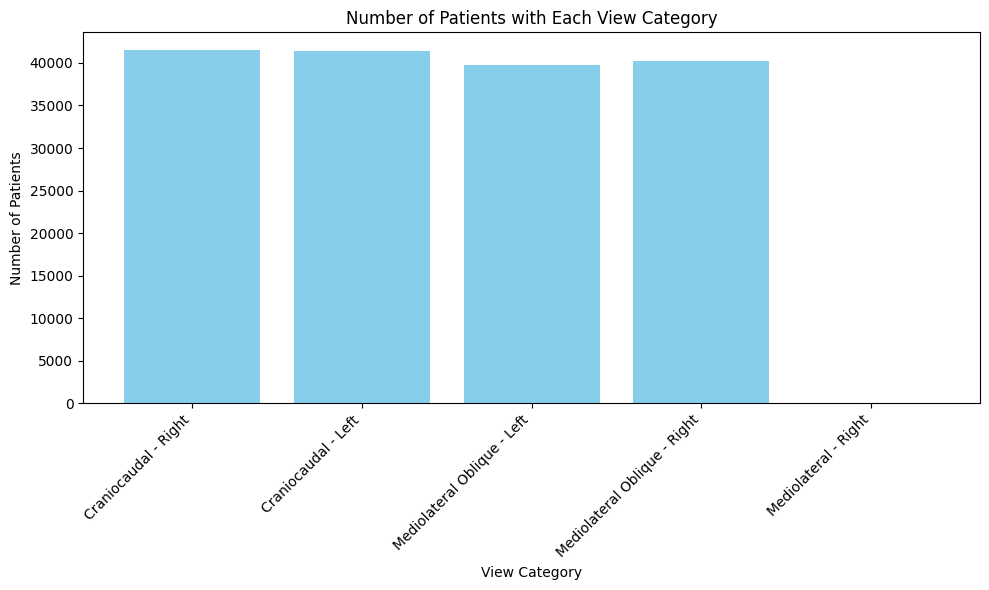

In [4]:
import os
import json
import matplotlib.pyplot as plt
from collections import defaultdict, Counter

metadata_folder = r"C:\Users\kanam\OneDrive\Desktop\ms thesis\256x256\2d_resized_256\metadata"

# Ensure the metadata folder exists
if not os.path.exists(metadata_folder):
    print(f"Error: The folder '{metadata_folder}' does not exist.")
    exit()

# Initialize data structures
labels = []
unique_views = set()
patient_views = defaultdict(set)
patients_views = defaultdict(set)

# Define the set of all possible views for the second script
all_views = {"cranio-caudal", "medio-lateral", "lateral", "other-view"}

# Process each metadata file
for filename in os.listdir(metadata_folder):
    if filename.endswith('.json'):
        file_path = os.path.join(metadata_folder, filename)
        try:
            with open(file_path, 'r') as f:
                metadata = json.load(f)
                
                # Extract labels and store them
                label = metadata.get("label", "Unknown")
                labels.append(label)
                
                # Extract unique views for the first script
                view = metadata.get("View", "Unknown")
                unique_views.add(view)
                
                # Map patient IDs to views for the first script
                patient_id = metadata.get("PatientID", "Unknown")
                patient_views[patient_id].add(view)
                
                # Categorize views and laterality for the second script
                view = view.lower()
                laterality = metadata.get("ImageLaterality", "").upper()

                # Skip files with missing data
                if not patient_id or not view:
                    print(f"Skipping file {file_path} due to missing data.")
                    continue

                # Categorize views
                if 'oblique' in view:
                    categorized_view = 'Mediolateral Oblique'
                elif 'cranio' in view:
                    categorized_view = 'Craniocaudal'
                else:
                    categorized_view = 'Mediolateral'

                # Determine laterality
                if 'L' in laterality:
                    laterality = 'Left'
                elif 'R' in laterality:
                    laterality = 'Right'
                else:
                    laterality = 'Unknown'

                # Store the categorized view and laterality for the second script
                patients_views[patient_id].add(f"{categorized_view} - {laterality}")

        except Exception as e:
            print(f"Error reading file {filename}: {e}")

# Analyze labels for the first script
label_counts = Counter(labels)
print("Image Counts by Type:")
for label, count in label_counts.items():
    print(f"{label}: {count}")

# Output unique views for the first script
print(f"\nUnique Views in Dataset: {unique_views}")

# Count patients with all views for the first script
patients_with_all_views = sum(1 for views in patient_views.values() if all_views.issubset(views))
print(f"\nNumber of patients with all 4 views: {patients_with_all_views}")

# Output views per patient for the first script
print("\nPatient Views (First Script):")
for patient_id, views in patient_views.items():
    print(f"Patient {patient_id}: {views}")

# Counting the patients with each combination of views for the second script
views_count = defaultdict(int)
for patient_id, views in patients_views.items():
    for view in views:
        views_count[view] += 1

# Print the results for the second script
print("\nNumber of patients with each view category (Second Script):")
for view, count in views_count.items():
    print(f"{view}: {count}")

# Create a bar plot for the views count
plt.figure(figsize=(10, 6))
plt.bar(views_count.keys(), views_count.values(), color='skyblue')
plt.title("Number of Patients with Each View Category")
plt.xlabel("View Category")
plt.ylabel("Number of Patients")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Show the plot
plt.show()



In [2]:
import os#merged code#Analysis of Metadata for Scan Counts and Patient Distribution by View-Laterality Combinations
import json
from collections import defaultdict, Counter

# Define the metadata folder path
metadata_folder = r"C:\Users\kanam\OneDrive\Desktop\ms thesis\256x256\2d_resized_256\metadata"

# Check if the folder exists
if not os.path.exists(metadata_folder):
    print(f"Error: The folder '{metadata_folder}' does not exist.")
    exit()

# Dictionaries to store scan counts and patient counts
view_counts = defaultdict(int)  # Total number of scans for each view-laterality combination
patient_views = defaultdict(set)  # Unique view-laterality combinations for each patient

# Process each metadata file
for filename in os.listdir(metadata_folder):
    if filename.endswith('.json'):
        file_path = os.path.join(metadata_folder, filename)
        try:
            with open(file_path, 'r') as f:
                metadata = json.load(f)
                patient_id = metadata.get("PatientID")
                view = metadata.get("View")
                laterality = metadata.get("ImageLaterality")

                # Skip invalid entries
                if not all([patient_id, view, laterality]):
                    continue

                # Standardize the view and laterality
                view = view.strip().lower().replace("cranio-caudal", "craniocaudal")
                laterality = laterality.strip().upper().replace("LEFT", "L").replace("RIGHT", "R")

                # Categorize views into the 4 categories (like Avanith's code)
                if 'oblique' in view:
                    categorized_view = 'Mediolateral Oblique'
                elif 'craniocaudal' in view:
                    categorized_view = 'Craniocaudal'
                else:
                    categorized_view = 'Mediolateral'

                # Combine categorized view and laterality
                full_view = f"{categorized_view} - {laterality}"

                # Update scan counts
                view_counts[full_view] += 1

                # Update patient counts
                patient_views[patient_id].add(full_view)

        except Exception as e:
            print(f"Error reading file {filename}: {e}")

# Count the number of unique patients for each view-laterality combination
patient_counts = defaultdict(int)
for patient_id, views in patient_views.items():
    for view in views:
        patient_counts[view] += 1

# Print the results
print("Total number of scans for each view-laterality combination:")
for view, count in view_counts.items():
    print(f"{view}: {count}")

print("\nNumber of unique patients for each view-laterality combination:")
for view, count in patient_counts.items():
    print(f"{view}: {count}")

Total number of scans for each view-laterality combination:
Craniocaudal - R: 41737
Craniocaudal - L: 41643
Mediolateral Oblique - L: 39880
Mediolateral Oblique - R: 40307
Mediolateral - R: 1

Number of unique patients for each view-laterality combination:
Craniocaudal - R: 41527
Craniocaudal - L: 41367
Mediolateral Oblique - L: 39795
Mediolateral Oblique - R: 40225
Mediolateral - R: 1
